In [1]:
from hmmlearn.hmm import MultinomialHMM
import pandas as pd
import numpy as np
import seaborn as sns



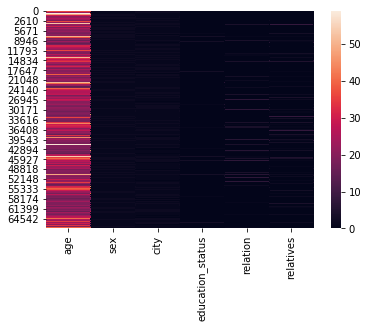

In [2]:

df = pd.read_csv('module1.csv')
df.head(10)
df = df.loc[(df['city'] < 10) & (df['age'] < 60) & (df['age'] != 0)]
sns.distplot(df['age'],bins=8)
sns.heatmap(df[['age','sex','city','education_status','relation','relatives']])

In [3]:
train_data = df[['age','sex', 'city', 'education_status']]
train_data.head(30)

,age,sex,city,education_status
0,36,1.0,1,0
1,31,1.0,2,0
3,31,2.0,1,0
5,36,2.0,2,3
8,29,1.0,2,0
9,30,1.0,2,0
16,36,2.0,2,0
18,31,2.0,2,0
20,36,1.0,2,0
25,30,1.0,1,0


In [4]:
train_data.iloc[:, :] = train_data.iloc[:, :].astype(np.int32)

In [5]:
#Hmm model
X = np.concatenate([train_data[['age']].values,train_data[['sex']].values, train_data[['city']].values,train_data[['education_status']].values])
lengths = [len(train_data[['age']].values),len(train_data[['sex']].values),len(train_data[['city']].values),len(train_data[['education_status']].values)]
model = MultinomialHMM(n_components=42)
model.fit(X,lengths=lengths)



MultinomialHMM(algorithm='viterbi', init_params='ste', n_components=42,
               n_iter=10, params='ste',
               random_state=RandomState(MT19937) at 0x1DC6E5E0570,
               startprob_prior=1.0, tol=0.01, transmat_prior=1.0,
               verbose=False)

In [6]:
X_synth, Z = model.sample(200)
X_synth

array([[1],
       [2],
       [1],
       [1],
       [1],
       [2],
       [2],
       [2],
       [1],
       [1],
       [1],
       [2],
       [1],
       [1],
       [1],
       [1],
       [1],
       [2],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [2],
       [1],
       [2],
       [1],
       [1],
       [1],
       [2],
       [1],
       [2],
       [1],
       [1],
       [2],
       [1],
       [1],
       [2],
       [2],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [2],
       [2],
       [2],
       [1],
       [1],
       [2],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [1],
       [2],
       [2],
       [1],
       [2],
       [1],
       [0],
       [1],
       [2],
       [2],
       [2],
       [2],
       [1],
       [1],
       [1],
       [1],
       [1],
       [2],
       [1],
       [1],
    

In [7]:
model.get_params

<bound method BaseEstimator.get_params of MultinomialHMM(algorithm='viterbi', init_params='ste', n_components=42,
               n_iter=10, params='ste',
               random_state=RandomState(MT19937) at 0x1DC6E5E0570,
               startprob_prior=1.0, tol=0.01, transmat_prior=1.0,
               verbose=False)>

In [8]:
model.transmat_

array([[9.46914755e-03, 2.01671076e-01, 3.75543624e-05, ...,
        1.00576434e-01, 3.34195427e-05, 4.81564143e-05],
       [1.01878136e-03, 2.78837389e-01, 8.11233635e-27, ...,
        1.94747530e-01, 1.04467522e-26, 9.19174210e-17],
       [5.48810837e-07, 4.86084658e-26, 4.46392642e-02, ...,
        4.29487304e-22, 3.08408865e-02, 4.51181280e-03],
       ...,
       [5.57801644e-04, 2.16634254e-01, 1.50577806e-22, ...,
        3.36990755e-01, 2.24173127e-22, 1.15264440e-16],
       [7.05181851e-07, 8.28569892e-26, 4.26280754e-02, ...,
        8.44403188e-22, 3.43736764e-02, 6.12713214e-03],
       [7.26316612e-06, 2.75263585e-15, 4.63224674e-02, ...,
        2.98438356e-15, 4.34961510e-02, 2.86623136e-02]])